In [1]:
import matplotlib.pyplot as plt
import cv2
from matplotlib.pyplot import figure
import os
from paddleocr import PaddleOCR,draw_ocr
import re
import numpy as np

## Step 1: Instance detection with YOLOv7 to get barcode and price location

1. Run python script yolov7/detect_custom.py to generate the bounding boxes for price and barcode
2. Generated output will be in yolov7/runs/detect

### Visualize output

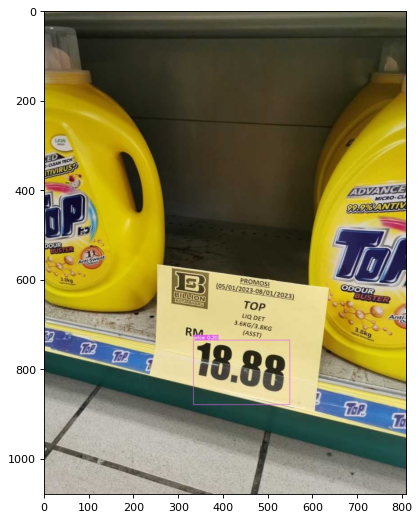

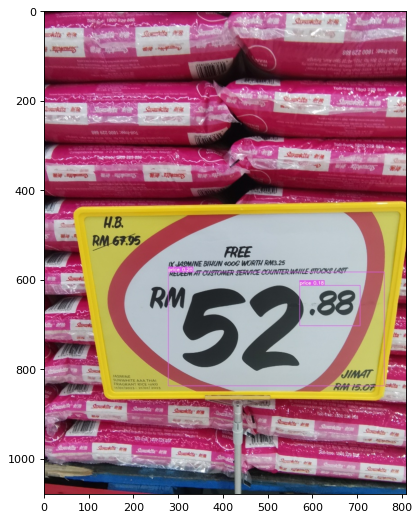

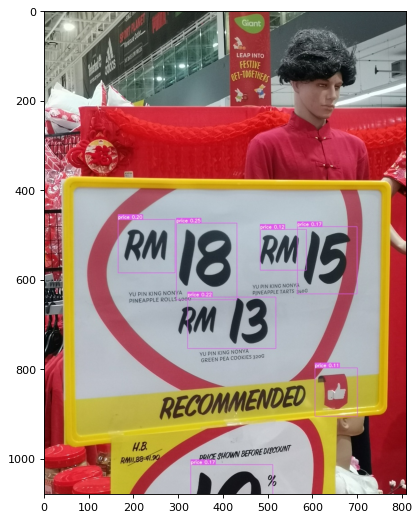

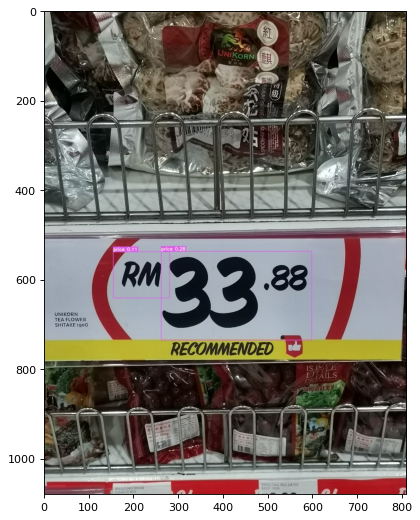

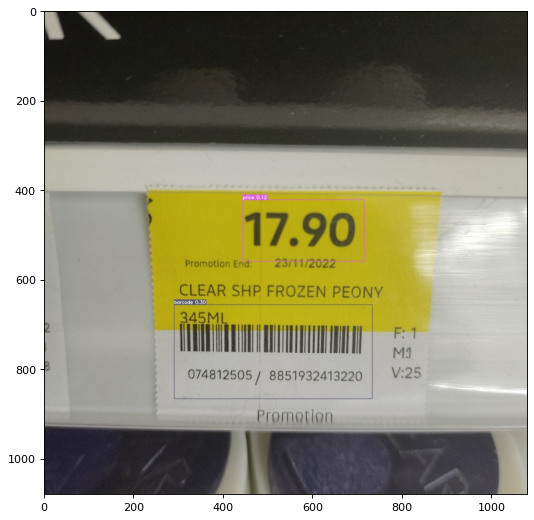

...

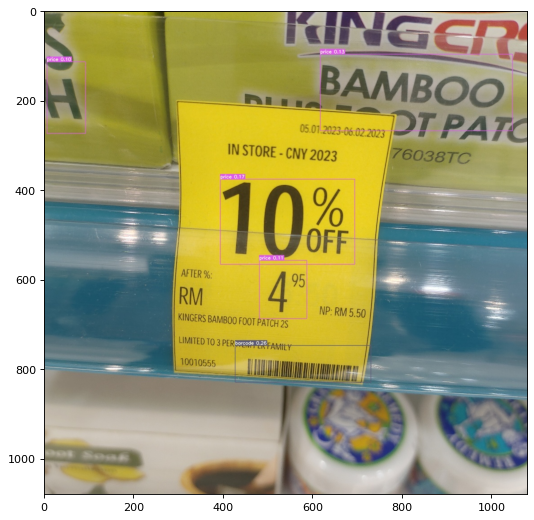

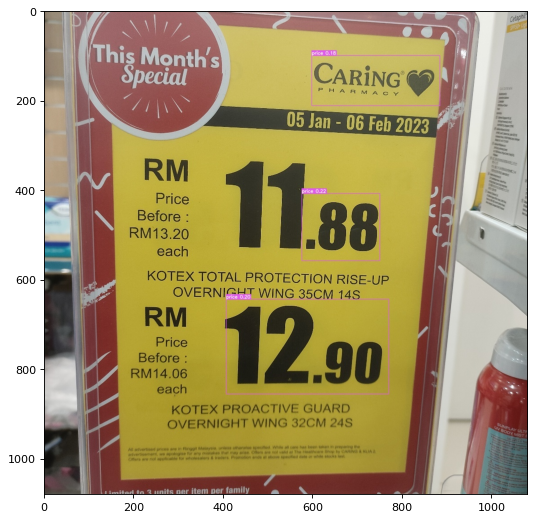

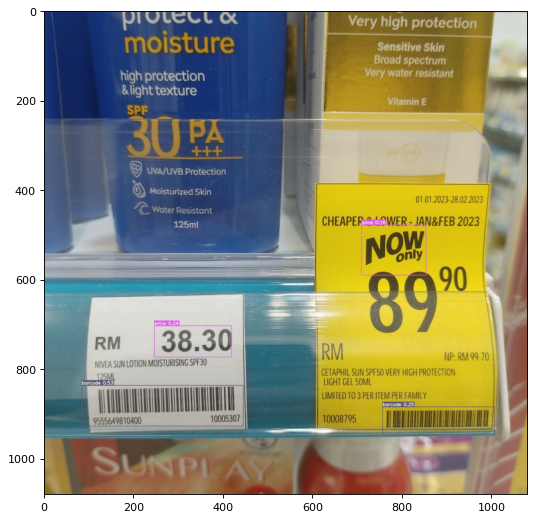

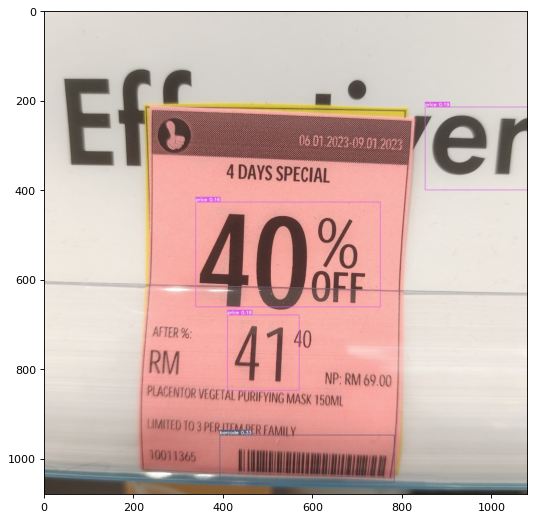

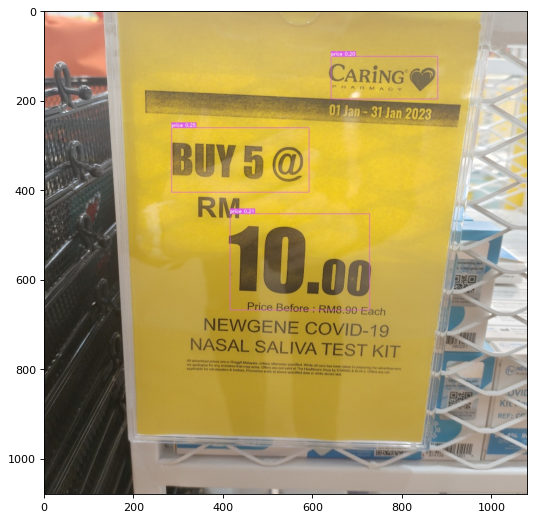

In [2]:
output_fol = r'yolov7\runs\detect\exp'
for i in os.listdir(output_fol):
    try:
        image_path = os.path.join(output_fol,i)
        img = cv2.cvtColor(cv2.imread(image_path),cv2.COLOR_BGR2RGB)
        figure(figsize=(10, 8), dpi=80)
        plt.imshow(img)
        plt.pause(0.001)
    except:
        pass

## Step 2: Crop the detected region and perform OCR on it

In [10]:
def getArea(box):
    return (box[2] - box[0]) * (box[3] - box[1])

def getBiggestBox(box_list):
    
    max_area =0
    for idx,box in enumerate(box_list):
        area = getArea(box[2:])
        if area > max_area:
            max_area = area
            max_value = idx
            
    return idx
   
def run_ocr(cropped_img):
    result = ocr.ocr(cropped_img, det=True, rec=True,cls=True)
    result = result[0]
    #boxes = [line[0] for line in result]
    txts = [line[1][0] for line in result]
    #scores = [line[1][1] for line in result]
    return txts

def get_coord(img,label_path):
    
    dh, dw, _ = img.shape

    fl = open(label_path, 'r')
    data = fl.readlines()
    fl.close()
    
    price_boxes = []
    barcode_boxes = []
    
    for dt in data:

        class_id, x, y, w, h,conf = map(float, dt.split(' '))
        
        l = int((x - w / 2) * dw)
        r = int((x + w / 2) * dw)
        t = int((y - h / 2) * dh)
        b = int((y + h / 2) * dh)

        if l < 0:
            l = 0
        if r > dw - 1:
            r = dw - 1
        if t < 0:
            t = 0
        if b > dh - 1:
            b = dh - 1
            
        if int(class_id)==0:
            price_boxes.append([int(class_id),conf,l,t,r,b])
        elif int(class_id)==1:
            barcode_boxes.append([int(class_id),conf,l,t,r,b])
    
    return price_boxes, barcode_boxes

def generate_empty_image():

    return np.ones(shape=(512,512,3), dtype=np.int16)

def vconcat_resize(img_list, interpolation 
                   = cv2.INTER_CUBIC):
      # take minimum width
    w_min = min(img.shape[1] 
                for img in img_list)
      
    # resizing images
    im_list_resize = [cv2.resize(img,
                      (w_min, int(img.shape[0] * w_min / img.shape[1])),
                                 interpolation = interpolation)
                      for img in img_list]
    # return final image
    return cv2.vconcat(im_list_resize)

In [11]:
# load ocr model
det_model = r"ocr_models\en_PP-OCRv3_det_infer"
rec_model = r"ocr_models\en_PP-OCRv3_rec_infer"
ocr = PaddleOCR(det_model_dir=det_model, rec_model_dir=rec_model, use_angle_cls=True,lang='en',show_log=False)

In [12]:
original_images = r"dataset\images"
output_images = r"yolov7\runs\detect\exp"
predicted_labels  = r"yolov7\runs\detect\exp\labels"

Price: 18.88 
Barcode: None


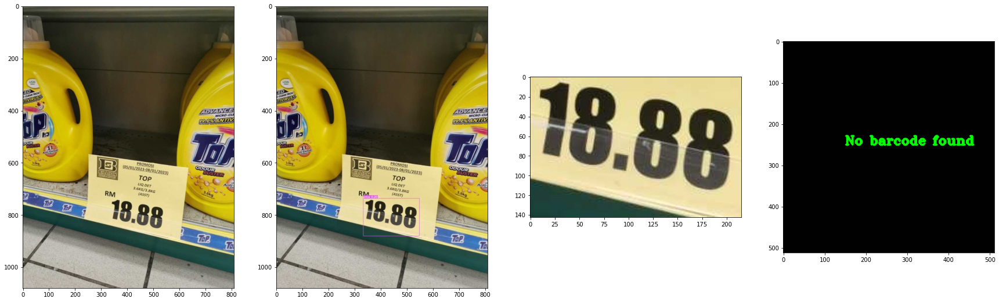

Price: 88 "52 .88 
Barcode: None


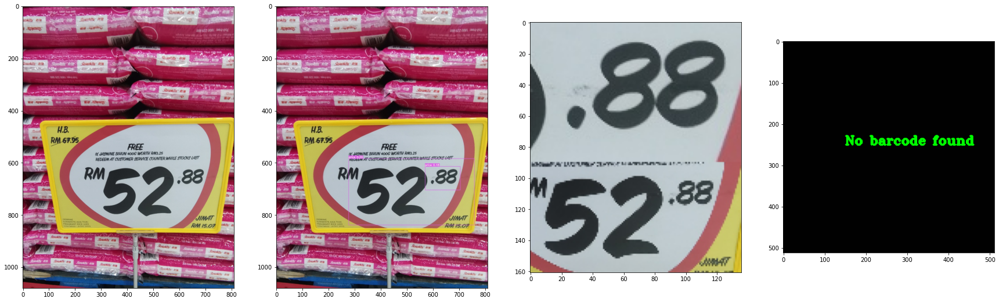

Price: M13 18 
Barcode: None


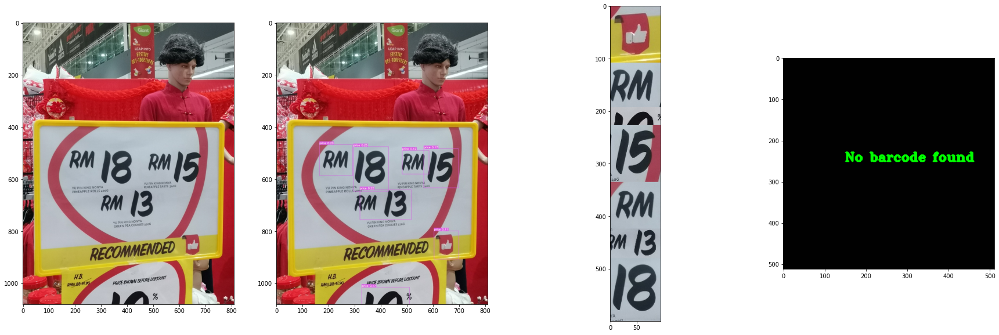

Price: 33 88 
Barcode: None


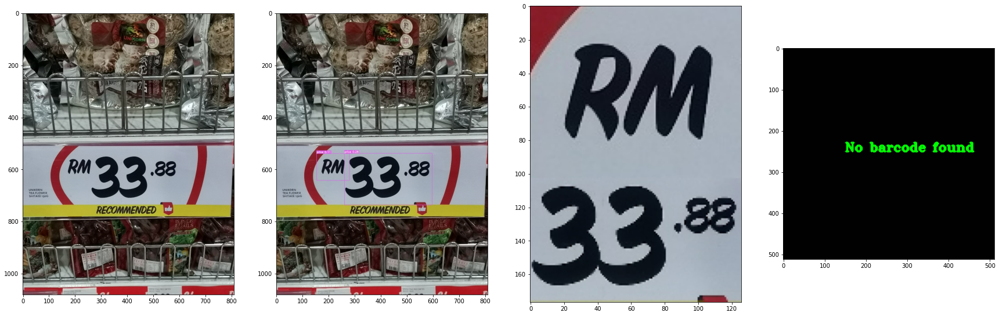

Price: 17.90 
Barcode: 8851932413220


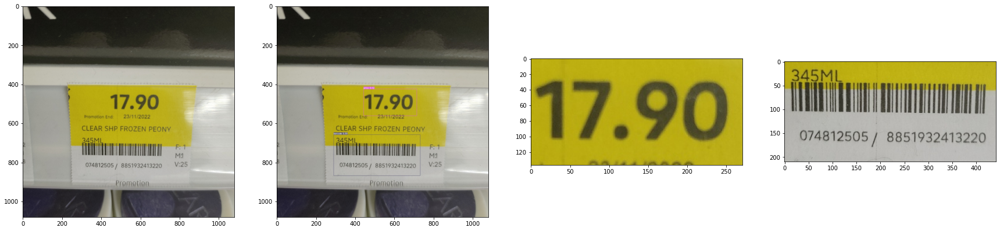

Price: 20 90 
Barcode: 8999999538039


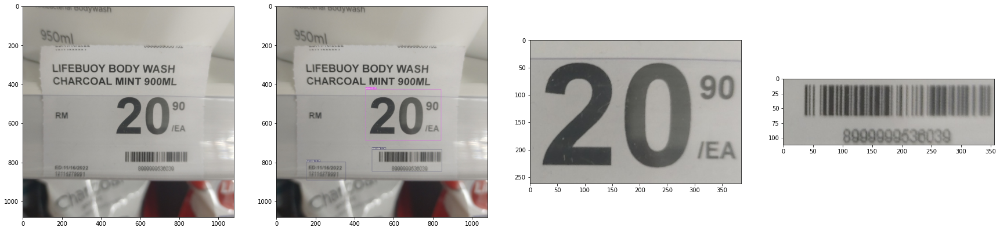

Price: 9.50 
Barcode: None


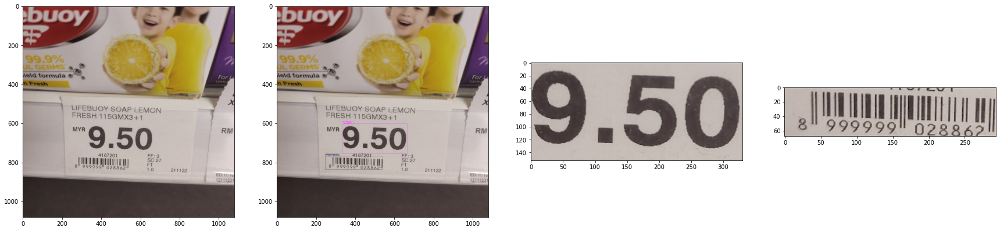

Price: 6.29 
Barcode: 9556024700460


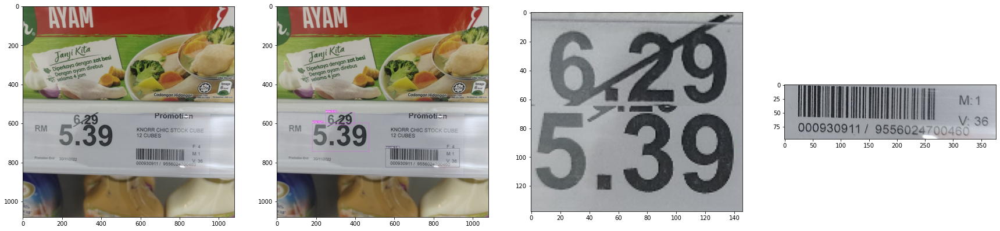

Price: 6.39 
Barcode: 9556126663762


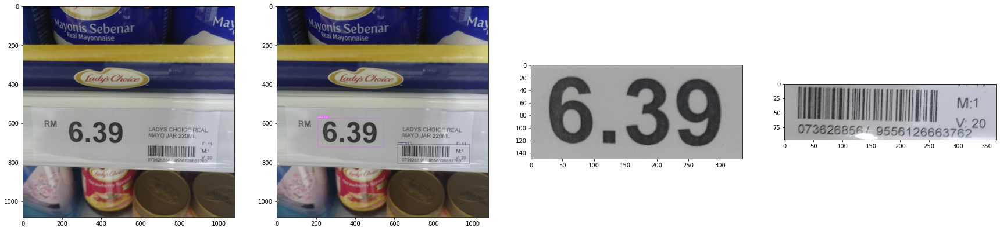

Price: 14.49 
Barcode: 000048744858


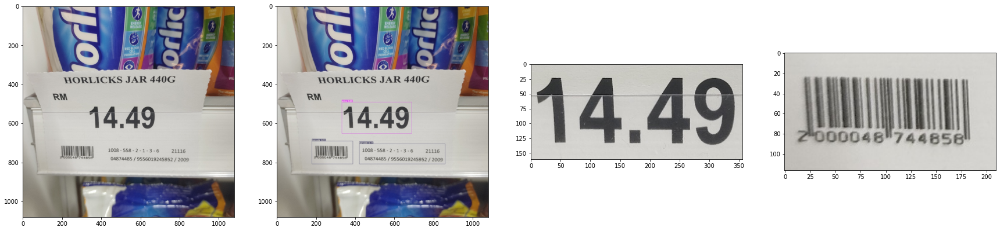

Price: 8.99 
Barcode: 8934868093084


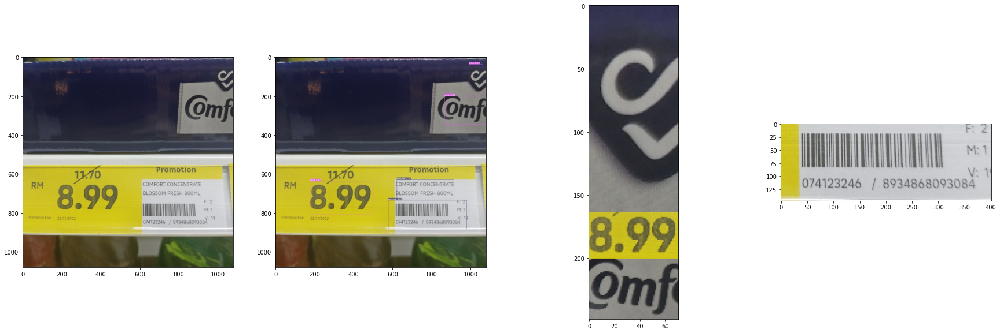

Price: 95 
Barcode: 8999999001478


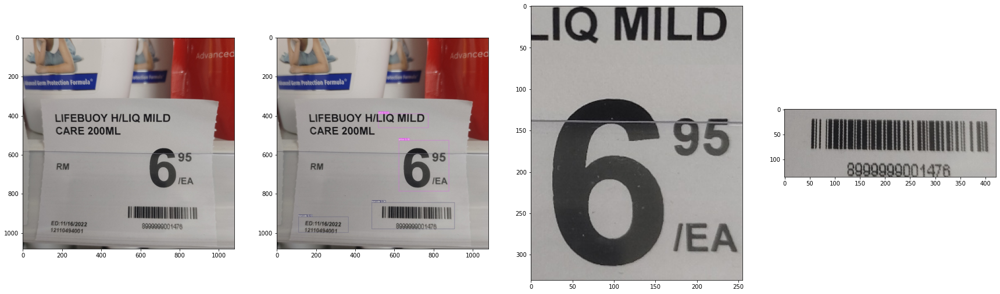

Price: 21.89 
Barcode: None


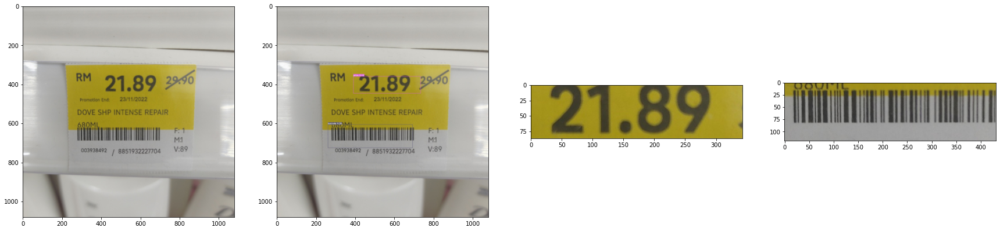

Price: 50 
Barcode: 9999991028831


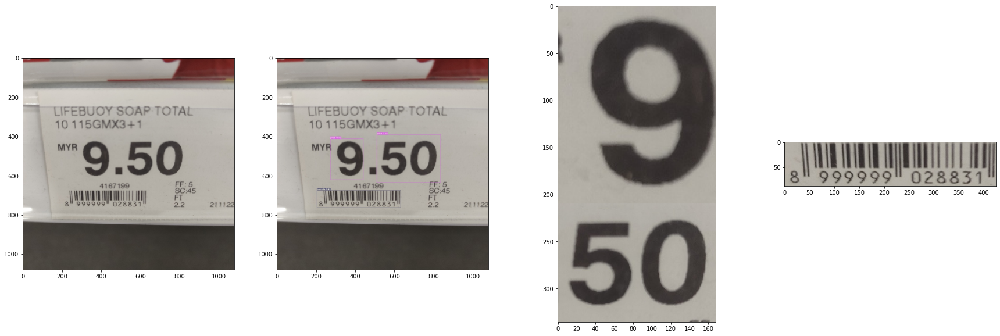

Price: 12.50 
Barcode: 9555558304083


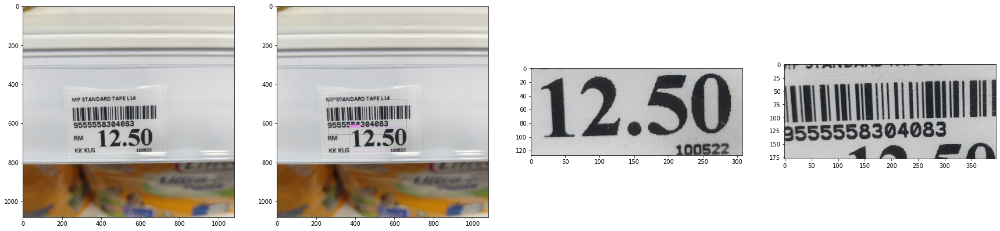

Price: 4.90 
Barcode: 3998866802536


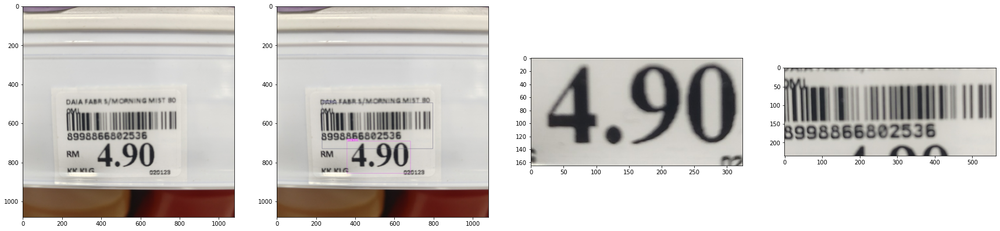

Price: 97 .80 
Barcode: 9555175005035


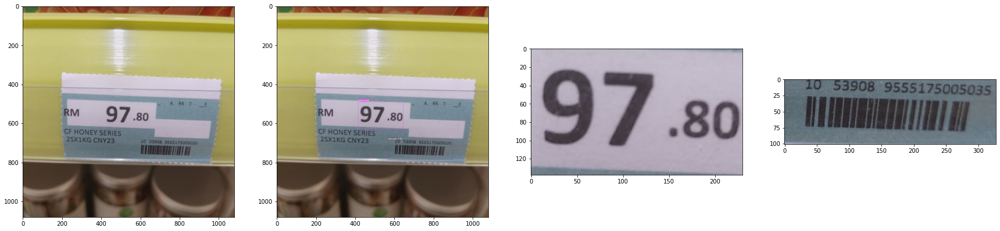

Price: 
Barcode: None


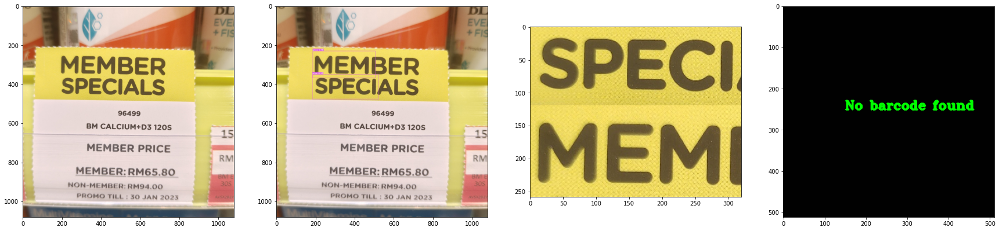

Price: 158 .28 
Barcode: None


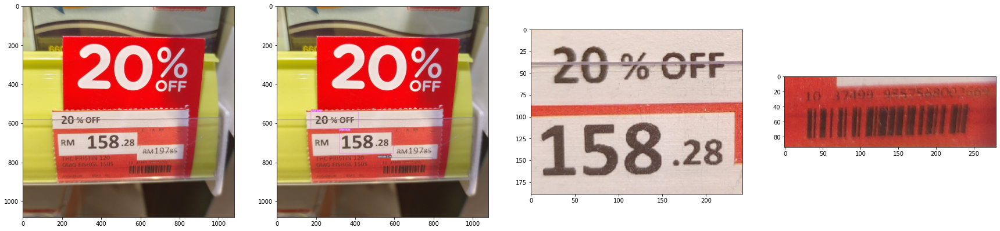

Price: 58 .05 
Barcode: 9557717031410


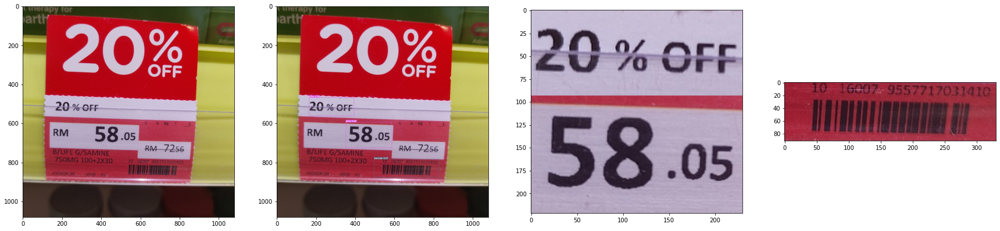

Price: 37.80 
Barcode: None


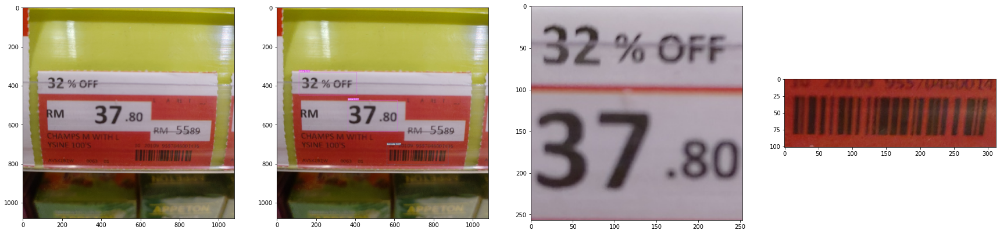

Price: 101 .00 
Barcode: 4005800302039


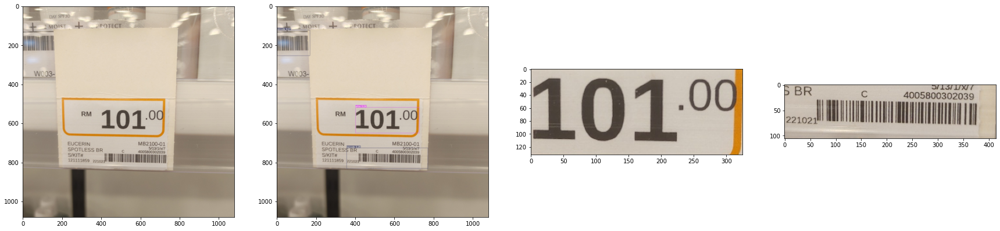

Price: 39 .20 49 
Barcode: None


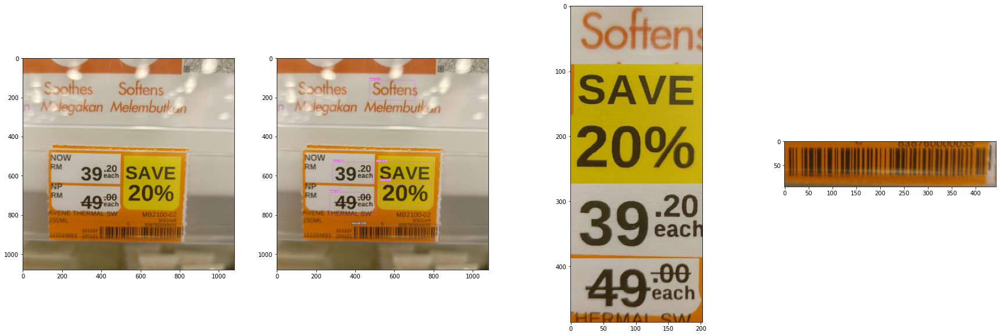

Price: 11.90 
Barcode: 200001"658745


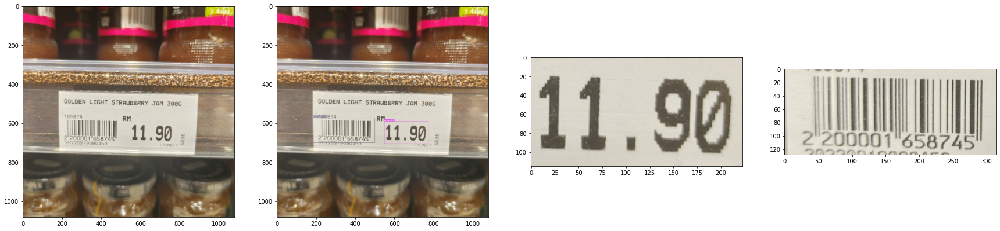

Price: 14.20 
Barcode: 200000"05729


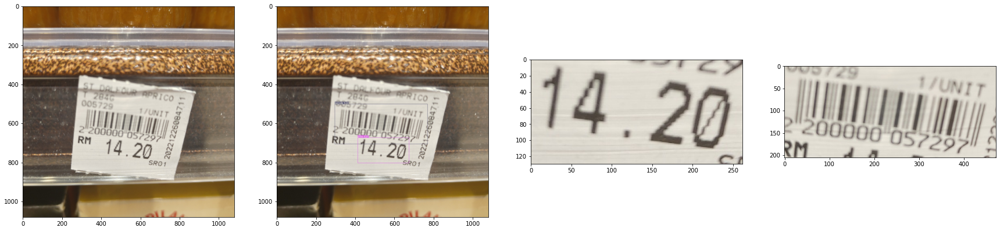

Price: 
Barcode: None


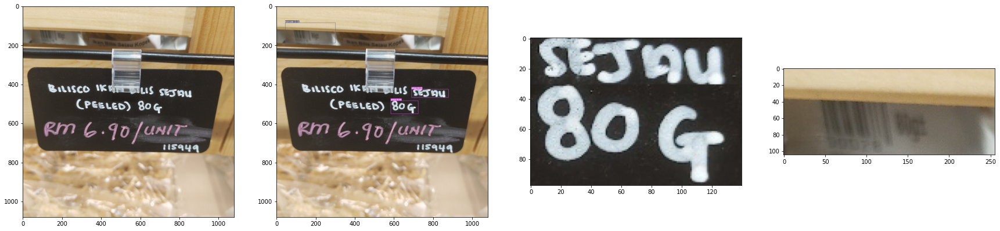

Price: 
Barcode: None


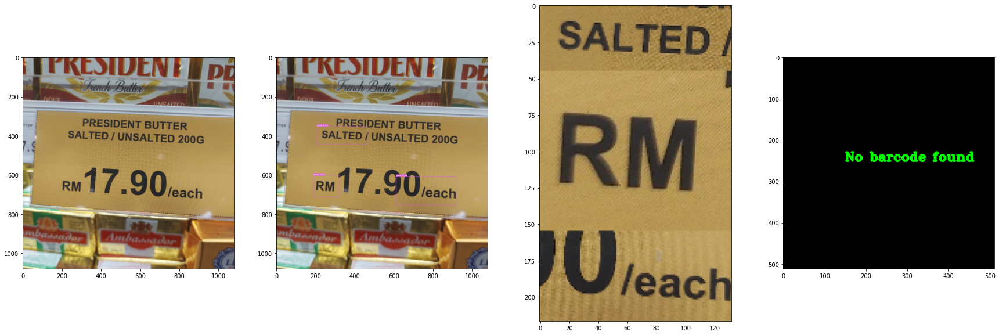

Price: SINCE 1947 SINCE 1947 5.88 
Barcode: None


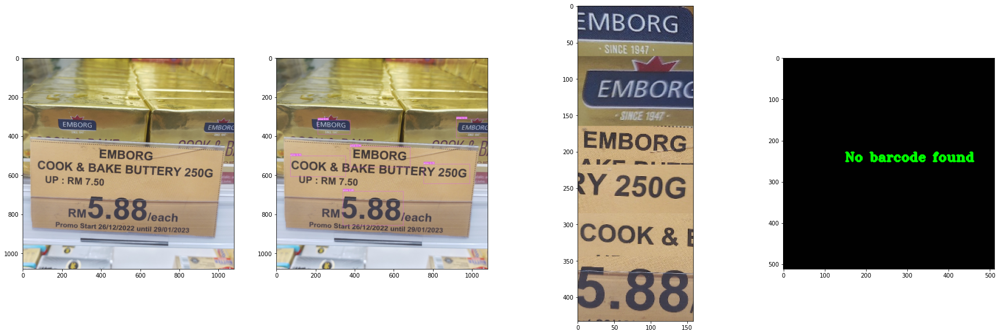

Price: 11.99 
Barcode: None


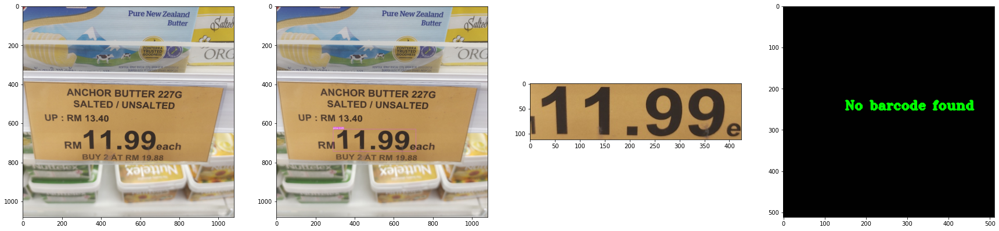

[Errno 2] No such file or directory: 'yolov7\\runs\\detect\\exp\\labels\\IMG_20230111_165549.txt'
Price: UP:RM7.99 
Barcode: None


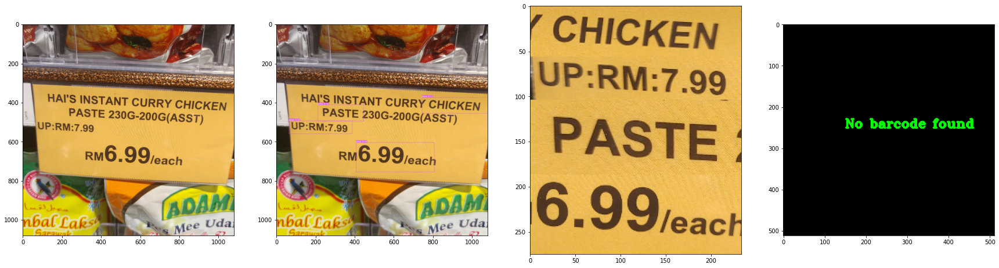

Price: 6.99 
Barcode: None


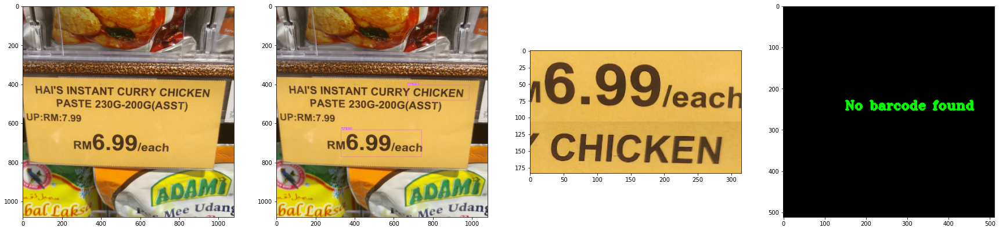

Price: 6.20 
Barcode: None


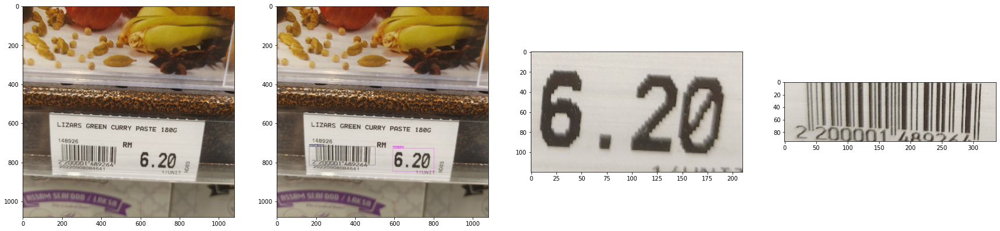

Price: 
Barcode: None


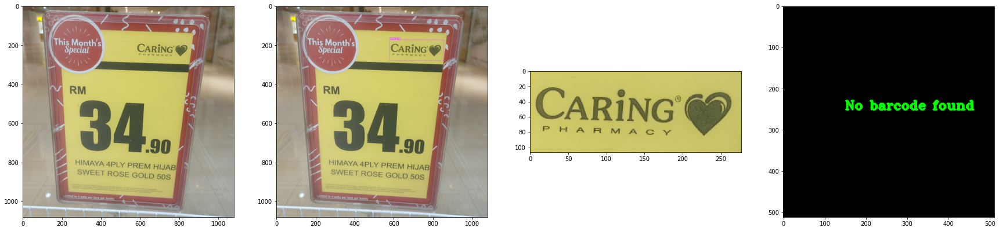

Price: 82.90 
Barcode: 9555046005881


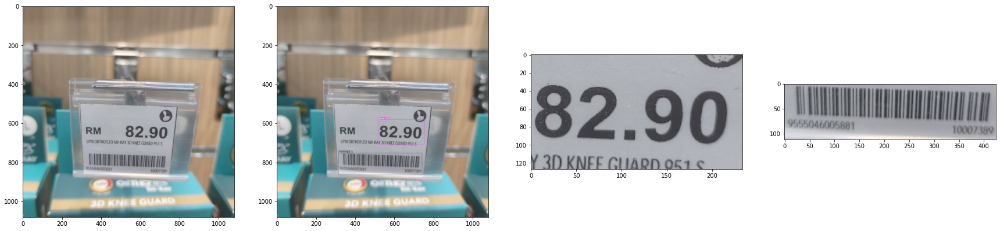

Price: 82.90 
Barcode: 9555046005881


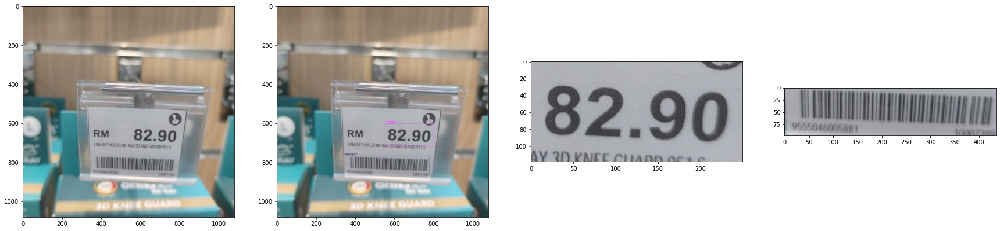

Price: 95 10 
Barcode: None


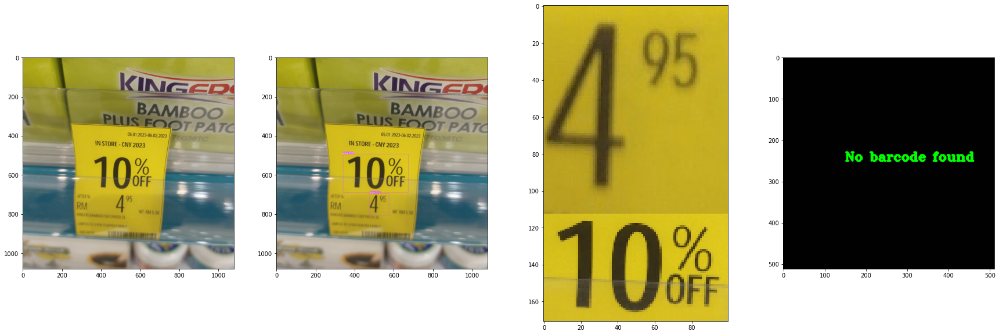

Price: 95 10 
Barcode: None


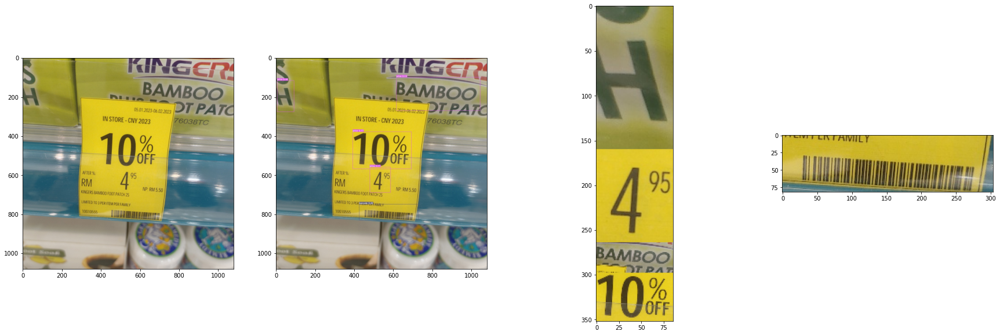

Price: 12 90 .88 
Barcode: None


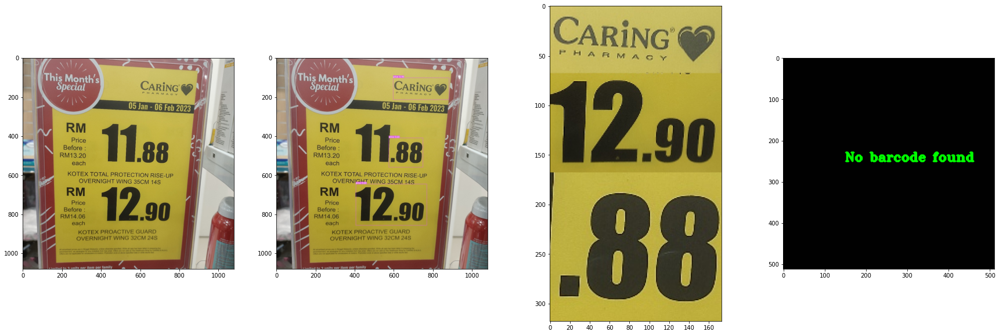

Price: 38.30 
Barcode: 9555649810400


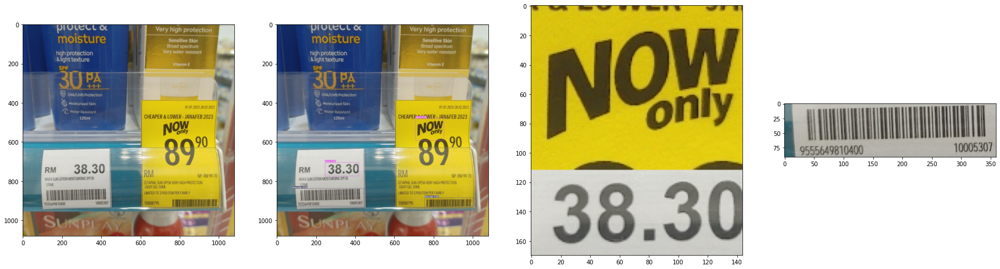

Price: 40 41 
Barcode: None


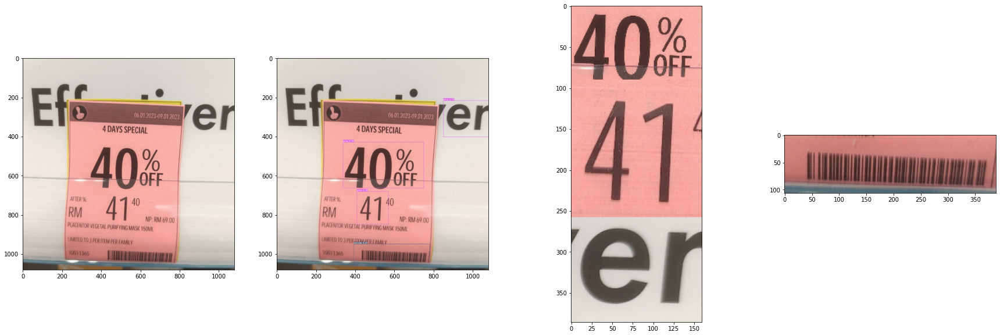

Price: 10 .00 
Barcode: None


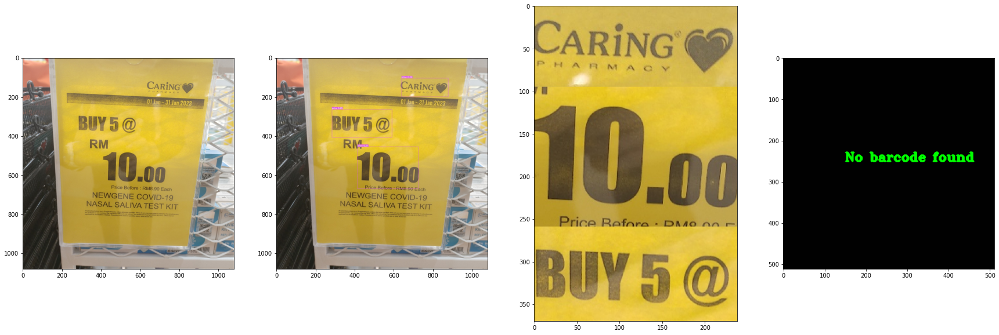

In [14]:

for img_name in os.listdir(original_images):
    
    try:
        img_path = os.path.join(original_images,img_name)
        output_path = os.path.join(output_images,img_name)
        label_path = os.path.join(predicted_labels,img_name.replace(".jpg",".txt"))

        # get the box for price and barcode
        img = cv2.cvtColor(cv2.imread(img_path),cv2.COLOR_BGR2RGB)
        out_img = cv2.cvtColor(cv2.imread(output_path),cv2.COLOR_BGR2RGB)
        price,barcode = get_coord(img,label_path)
        
        price_val = None
        all_price_img = None
        if len(price)!=0:

            #largest_price_idx = getBiggestBox(price)
            #largest_price_box = price[largest_price_idx]
            #largest_price = img[largest_price_box[3]:largest_price_box[5], largest_price_box[2]:largest_price_box[4]]

            
            # crop image to include only the detected regions
            
            for idx,boxes in enumerate(price):
                cropped_price = img[price[idx][3]:price[idx][5], price[idx][2]:price[idx][4]]
                if all_price_img is None:
                    all_price_img = cropped_price
                else:
                    all_price_img = vconcat_resize([all_price_img, cropped_price])

            # perform ocr on the regions
            price_txt = run_ocr(all_price_img)

            # process the ocr results and get the final price value
            price_val = ''
            for i,res in enumerate(price_txt):
                if re.search(r"(\d+\.\d{1,2})", res):
                    price_val+=res+" "
                    break

                elif re.search(r'.[0-9]+$', res):
                    price_val+=res+" "


        else:
            price_val=None
            cropped_price = generate_empty_image()
            cv2.putText(img=cropped_price, text='No price found', org=(150, 250), fontFace=cv2.FONT_HERSHEY_TRIPLEX, fontScale=1, color=(0, 255, 0),thickness=3)
        
        print("Price: " +str(price_val))
        
        barcode_val = None
        if len(barcode)!=0:
            final_barcode_idx =  getBiggestBox(barcode)
            final_barcode_box =  barcode[final_barcode_idx]


            # crop image to include only the detected region
            cropped_barcode = img[final_barcode_box[3]:final_barcode_box[5], final_barcode_box[2]:final_barcode_box[4]]


            barcode_txt = run_ocr(cropped_barcode)
            for j,res in enumerate(barcode_txt):
                
                barcode_matched =re.findall(r'[0-9" ]{12,13}$',res)
                if len(barcode_matched)>0:
                    barcode_val = barcode_matched[0]
 

        else:
            cropped_barcode = generate_empty_image()
            cv2.putText(img=cropped_barcode, text='No barcode found', org=(150, 250), fontFace=cv2.FONT_HERSHEY_TRIPLEX, fontScale=1, color=(0, 255, 0),thickness=3)
        
        print("Barcode: " +str(barcode_val))

        f, axarr = plt.subplots(1,4)
        f.set_figwidth(30)
        f.set_figheight(10)

        axarr[0].imshow(img)
        axarr[1].imshow(out_img)
        axarr[2].imshow(all_price_img)
        axarr[3].imshow(cropped_barcode)
        plt.pause(0.001)
    except Exception as e:
        print(e)
